# How to make multi-index index charts with Plotly
## Index charts with more insights

## 0. Introduction: Why index charts with multiple indices are better

When working with time series data, raw numbers often provide little insight. If you have multiple variables that vary in magnitude, changes in smaller values are hard to see. There is a simple solution to this problem: Using **index charts** that index the data. Indexing is achieved by selecting a reference point in time (**index**), setting the variables to an equal value at the index (**index value**) and examining their change over time relative to the index value. 

While regular index charts work fine, by using a simple extension to indexing you can significantly improve your visual presentation and help your charts communicate causalities in the data. This extension is what I refer to as "**multi-indexing**" - using multiple indices instead of one. This technique allows you to analyze data from different vantage points. It is especially useful when you suspect that there were events at specific points in time that had a significant influence on the growth of variables in question. 

As an example, if you were to compare stock prices for some stocks from 1980 to today, you would find that the [Black Monday in 1987](https://en.wikipedia.org/wiki/Black_Monday_(1987)), the [Dot-com bubble in 2000](https://en.wikipedia.org/wiki/Dot-com_bubble), and the [stock market crash in 2008](https://en.wikipedia.org/wiki/Financial_crisis_of_2007%E2%80%932008) were all events that influenced the market heavily and would be interesting to look at. So, you would add them to the indices list, reference data to each of these dates and compare how the prices developed with respect to each reference point. Looking at the prices this way would give you a better intuition of the magnitude of each event compared to just a single index date. 

In this article I will teach you how you can implement multi-indexing in time-series plots using the Python Plotly data visualization library. I will present three approaches with complete code and explain them in detail, including the advantages and disadvantages of each approach and when to use which. To keep up with the article, you should be familiar with Python and Pandas and preferably have had some exposure to Plotly.

If you care about only one of the three charts I will talk about, feel free to skip the others - the article is written in a modular way, so you won't miss anything. However make sure to thoroughly read part 1 (*Setup and Preparation*), because it contains important concepts and function definitions that will be used in every chart.

**Article index**

1. [Setup and preparation](./#1.+Setup+and+preparation)

2. [Index chart with fixed reference dates](./#2.+Index+chart+with+fixed+reference+dates)

<img src="./gifs/button_index_chart.gif" width=600/>

3. [Dynamic index chart](./#3.+Dynamic+index+chart)

<img src="./gifs/dynamic_index_chart.gif" width=600/>

4. [Index chart with variable index in JupyterLab](./#4.+Index+chart+with+variable+index+in+JupyterLab)

<img src="./gifs/datepicker_index_chart.gif" width=600/>



## 1. Setup and preparation

### 1.1 Fetching and cleaning data

As already mentioned, data preparation tasks will be done with Pandas. Most of the plotting will be handled by the Plotly ```graph_objects``` module. Additionaly for one plot we will use the ```ipywidgets``` library, which provides widgets for interacting with plots in Jupyter Notebook and JupyterLab. 
For the time series data we are going to use historic stock market data from Yahoo!Finance API. There is a great Python library called ```[yfinance](https://pypi.org/project/yfinance/)``` which we will use to interface with the API.

Our goal is to build index charts that will enable the user to compare the development of selected stocks relative to a selected date on the first glance. So, let's pick some stocks to compare. We will be featuring Facebook (FB), Amazon (AMZN), DowDupont (DD) and also Berkshire Hathaway class A shares (BRK-A) which is the highest-ever priced share for a stock. I purposefully chose stocks from a very broad price range, to demonstrate the effectiveness of indexing. 

In [1]:
# Imports
import pandas as pd
from ipywidgets import widgets as wg
import yfinance as yf
import plotly.graph_objects as go
from plotly.offline import init_notebook_mode, iplot

init_notebook_mode()

tickers = ["FB", "AMZN", "DD", "BRK-A"]

df = yf.download(
        tickers=tickers,
        period="3y",
        interval="1wk",
        group_by="column")
        
df.head(5)

[*********************100%***********************]  4 of 4 completed


Adj Close                                         Close  \
                   AMZN     BRK-A         DD          FB         AMZN   
Date                                                                    
2018-01-22  1402.050049  325915.0  99.039925  190.000000  1402.050049   
2018-01-29  1429.949951  314340.0  91.157372  190.279999  1429.949951   
2018-02-05  1339.599976  294140.0  89.344238  176.110001  1339.599976   
2018-02-12  1448.689941  306000.0  92.520416  177.360001  1448.689941   
2018-02-19  1500.000000  304020.0  94.204948  183.289993  1500.000000   

                                                     High            ...  \
               BRK-A          DD          FB         AMZN     BRK-A  ...   
Date                                                                 ...   
2018-01-22  325915.0  109.620239  190.000000  1402.530029  325915.0  ...   
2018-01-29  314340.0  100.895592  190.279999  1498.000000  326350.0  ...   
2018-02-05  294140.0   98.888779  176.110001  1460.989990  311850.0  ...   
2018-02-12  306000.0  102.404259  177.360001  1468.939941  309590.0  ...   
2018-02-19  304020.0  104.268745  183.289993  1503.489990  307770.0  ...   

                   Low                     Open                        \
                    DD          FB         AMZN     BRK-A          DD   
Date                                                                    
2018-01-22  107.115280  186.600006  1368.000000  324600.0  108.638184   
2018-01-29  100.539772  181.839996  1409.180054  325650.0  109.620239   
2018-02-05   94.206223  167.179993  1402.619995  308500.0   99.899307   
2018-02-12   99.486557  171.839996  1364.670044  298100.0   99.913536   
2018-02-19  100.938293  175.110001  1446.489990  305400.0  101.906113   

                            Volume                                   
                    FB        AMZN   BRK-A          DD           FB  
Date                                                                 
2018-01-22  187.949997   9610300.0   600.0   9036200.0   35136900.0  
2018-01-29  188.750000  38238000.0  2700.0  34879200.0  165475700.0  
2018-02-05  186.929993  52444600.0  4200.0  55992200.0  176854500.0  
2018-02-12  177.059998  28741300.0  1600.0  26480900.0  124398600.0  
2018-02-19  175.770004  22079800.0  1100.0  18667800.0   81877200.0  

[5 rows x 24 columns]

The call to ```yf.download()``` downloads data for the given time period in given intervals, in our case starting from today and dating 3 years back, once per week. The result is stored in a multi-indexed Pandas dataframe. 

Setting ```group_by='column'``` specifies how the data will be grouped, either by price type (column) or tickers (ticker). This translates to whether price types or tickers will be the top-level index of our dataframe.

The table contains five different prices. To simplify things, we will only look at the adjusted closing price and drop everything else. We'll remove empty values as well.

In [2]:
df = df.filter(regex="Adj Close")
df = df.dropna()
df.head(5)

Adj Close                                 
                   AMZN     BRK-A         DD          FB
Date                                                    
2018-01-22  1402.050049  325915.0  99.039925  190.000000
2018-01-29  1429.949951  314340.0  91.157372  190.279999
2018-02-05  1339.599976  294140.0  89.344238  176.110001
2018-02-12  1448.689941  306000.0  92.520416  177.360001
2018-02-19  1500.000000  304020.0  94.204948  183.289993

### 1.2 Indexing: Why And How

Now that our data is ready, let's take a first glance at the values.

<AxesSubplot:xlabel='Date'>

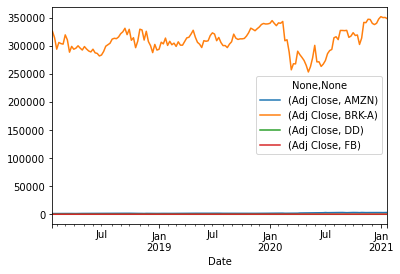

In [3]:
df.plot()

Plotting raw values helps little in comparing the stocks. Due to by magnitudes higher prices of BRK-A shares, changes in all other stocks are practically invisible. Maybe scaling the data logarithmically will alleviate the problem? 

<AxesSubplot:xlabel='Date'>

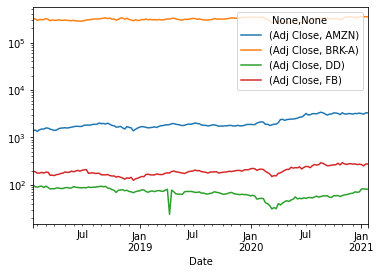

In [4]:
df.plot(logy=True)

Even at logarithmic scale the discrepancy in values is too big for us to meaningfully compare the stocks. It is evident that we need indexing.

Indexing is simple: Pick a date $D$, the index, and divide the price at every date by the value at date $D$. Now, all resulting values are represented as their ratio to the value $V$ at $D$ and can be easily compared to each other. In our case, we need to distinguish between different stocks, so for every stock we divide all values by the value at date D for the respective stock. We can do this easily in Pandas, as we have a multi-indexed dataframe. Calling ```iloc``` on a specific index returns a Pandas series containing the values of all stocks for the specific index. When we divide the dataframe by a series, Pandas divides every column by the corresponding element in the series.

We will also add some cosmetics. Multiplying the new values by 100 will give us percentage values, that are more comfortable to work with. The second optional cosmetic is subtracting 100 from the result. This effectively sets 100% to 0% and changes *ratio* to *relative difference*. As an example, a drop to 30% of the original value will now be interpreted as ```original value - 70%```. Personally, I think that this interpretation is easier to comprehend.

Note that I will refer to the index date as *reference date* and index value as *reference value*. This is done to avoid confusion with the dataframe index.


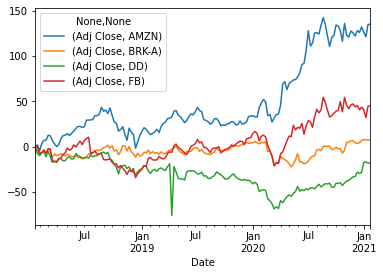

In [5]:
# use the first date as index 
reference_value = df.iloc[0]

# dividing by the series divides each column by the 
# corresponding element in the series
tmp_df = df.div(reference_value) * 100 - 100

tmp_df.plot()

prepared_df = df.copy()

This looks much better. The stock price trends are immediately visible and comparable. 

We are going to use indexing many more times, so let's write a generalized function ```create_indexed_columns()``` for this technique. The function will take the following parameters:

1. ```date``` - the reference date that is the index
2. ```df```   - the dataframe to work on
3. ```top_level_name``` - (optional) name for the top level index of the normalized dataframe

and return a new dataframe with normalized data and a new top level index.

One important consideration is how to handle an input date that is not in the dataframe. Luckily, dataframe indices have a very useful method ```get_loc()``` that will find the integer index of given index. When we pass the ```method=nearest``` parameter to the method, Pandas will search for the closest index to the provided input. As our index is of type ```datetime```, the date that is closest to the provided date will be matched.

In [6]:
def create_indexed_columns(date, df, top_level_name=""):
    """Returns indexed columns for given dataframe"""

    # find index of the date that is closest to our reference date
    closest_date_index = df.index.get_loc(date, method="nearest")

    # get the values in the initial columns for the reference date 
    reference_values = df.iloc[closest_date_index]['Adj Close']

    # divide initial columns by values at ref. date and store in intermediate df
    inter_df = df['Adj Close'].div(reference_values)*100 - 100

    # create a multindex for the intermediate df using the date as top-level index
    closest_date = df.index[closest_date_index]
    inter_df.columns = pd.MultiIndex.from_product(
                    [[top_level_name if top_level_name else str(closest_date)], inter_df.columns])
    
    return inter_df, closest_date


Before we move on to the first Plotly index chart, let's recap the concept of **"multi-index"** charts. As we have seen, indexing data to one point in time is very effective. However, often it is useful to look at multiple reference points. These might be specific events in the time series that had a big influence on our data. Looking at the data from multiple points gives the user the ability to easily see how the variable in question has grown relative to *different* reference points. The best way to accomplish this is to embed this functionality directly into the chart.

### 1.3 Very Short Plotly Crashcourse

This quick introduction only briefly touches on the basic concepts of Plotly. Skip it if you have worked with Plotly before.

Having multiple indices in a plot implies that they need to be switchable on the fly, therefore our plot has to be interactive. Plotly is interactive out of the box and extending interactability is relatively simple, which is why Plotly is the library of choice.

In Plotly, every figure is a JSON-like data structure with three main properties (called *attributes*): data, layout and frames. The first two are self-explanatory while the frames attribute contains optional frames that are used in animations. You can either first write the entire figure structure using JSON or Python dictionaries and then instantiate the figure object, or create the figure object first and update figure attributes incrementally.

As a warm up, let's recreate the default matplotlib chart that we generated by calling ```df.plot()``` in Plotly.


In [7]:
# instantiate the figure object
fig = go.Figure()

# add a scatter trace for every column
for col in df.columns:
    fig.add_scatter(x=df.index, y=df[col], name=col[1])

# change the scale to logarithmic and add title
fig.update_layout(
    yaxis=dict(type="log"),
    title=f"Stock prices for {df.index[0].strftime('%B %Y')} - " \
          +                f"{df.index[-1].strftime('%B %Y')}"
)

fig.show()

In the above example we instantiate the Figure object and then add individual traces to said object one by one. We can call ```update_layout()``` with a dictionary of updated attributes to change the layout of the figure.

All changes to a Plotly figure are done this way, passing a dictionary of attributes to the figure. Plotly supports "magic underscore notation" which means that we don't need to stepwise deepen into the object to access inner attributes but rather are able to access inner attributes directly. For example, we can simply write ```fig.update_layout(yaxis_type='log')``` instead of accessing the ```type``` attribute of the ```yaxis``` attribute - in many cases a more readable approach.

Now that we are all set, we can get on to our first chart.

## 2. Index chart with fixed reference dates

For this chart, we are going to use preselected dates around the time of stock market recessions and dates that had an impact on the companies we are analyzing. The dates listed below may not be entirely accurate, but they lay approximately in the timerange of the listed events.


In [8]:
ref_dict = {
    "Cambridge Analytica scandal": "2018-03-28",
    "DowDuPont separation":        "2019-04-15",
    "Corona stock market drop":    "2020-02-14"
}

We will index our data with respect to each of these dates and include all differently indexed data in our chart. Switching between the different indexed data will be accomplished by using a dropdown menu with an item for every reference date. Plotly refers to this as "buttons". Clicking a button will display only the data indexed by the respective reference date.
To achieve this, we need to switch the visibility of the traces we want to show to on, and switch it off for the remanining traces.

First, let's calculate values for each reference date and populate our dataframe with the resulting data.
We will create a new dataframe for each reference date and then join them into one dataframe. We will also store the closest date to the given reference date, in case that we don't have values for that reference date.

In [9]:
# tmp_dict for storing updated reference date dict entries
tmp_dict = {}
fixed_df = df.copy()

for ref_name, ref_date in ref_dict.items():
    # create intermediate df for reference date
    inter_df, closest_date = create_indexed_columns(ref_date, fixed_df, top_level_name=ref_name)
    
    fixed_df = fixed_df.join(inter_df)
    tmp_dict.update(
        {ref_name: dict(
            initial_date=ref_name,
            closest_date=closest_date)}
    )

# update values in original dict
ref_dict.update(tmp_dict)

Now that our table is transformed we can build our Plotly object. We will create a new figure and add a trace for each newly computed column. We are going to provide an additional ```meta``` attribute to every trace. The ```meta``` attribute can store arbitrary JSON data and has many applications. We will use it to store the reference date that a trace belongs to. This will allow us to identify a group of traces that will be switched to visible/invisible at the same time.

In [10]:
ref_date_fig = go.Figure()

# loop over reference dates
for ref_name in ref_dict.keys():
    # loop over tickers for reference date
    for ticker in fixed_df[ref_name].columns:
        ref_date_fig.add_scatter(
            x=fixed_df.index,
            y=fixed_df[ref_name, ticker],
            name=ticker, 
            meta=dict(reference_date=ref_name)
        )


ref_date_fig.show()

That's a lot of traces! We want to show only those that belong to one reference date. Just like before, we won't hardcode the buttons for our exact data. It is better to generalize our procedure so that we'll be able to handle a different set of reference dates and tickers.

To show or hide traces, we will need to set the ```visibility``` attribute of our figure. Because this is an attribute of the figure and not an individual trace, by default changes to this attribute apply to all traces. Internally, visibility is represented as an array of boolean values, where the value at a specific index represents the visibility of the trace with the same index. The trace index is the position of a trace within that array and because traces are added one by one,  trace index represents the order in which the traces were added to the figure. 

The visibility array allows us to target individual traces, either by passing the index of a specific trace or passing an array of boolean values where the value at each index indicates whether the corresponding trace will be shown. For example, with 4 traces, passing the array ```[True, False, True, False]``` will display only the first and third trace.

As you can imagine, relying on the order in which the traces were added to create permanent buttons is a brittle approach. If you add traces in a different order or add more traces, every mention of the visibility array would have to be checked and updated manually. This is why we added the ```meta``` attribute - this way, we don't need to rely on the order of the traces to identify which traces to switch on/off.

A simple function ```create_visibility_array``` will create the visibility array by comparing the meta value of every trace to the passed in value.

In [11]:
def create_visibility_array(ref_date):
    """
    Returns array of boolean values representing the
    visibility array of figure traces. Traces with the 
    same meta value as 'ref_date' are set to 'True'.
    """

    return [True if trace['meta']['reference_date'] == ref_date 
            else False for trace in ref_date_fig['data']]

Finally, we will write a function for generating buttons.

In [12]:
def create_buttons():
    """Returns list of button objects."""
    
    button_list = []
    for ref_date in ref_dict.keys():
        ref_button = dict(
            label=ref_date, 
            method="restyle",
            args=[dict(
                visible=create_visibility_array(ref_date))]
        )
        button_list.append(ref_button)
    return button_list

Let's clarify the button description. ```method``` specifies the Plotly method that the button calls on clicking. ```restyle``` updates the data and the layout of the plot. The ```args``` argument takes a list of chart attributes that will be updated by clicking the button, in our case the visibility attribute.

Lastly we will add the buttons to the figure and inspect the result.

In [13]:
ref_date_fig.update_layout(
    updatemenus=[dict(buttons=create_buttons())])
    
# hide traces on initialization, by default all traces are shown
ref_date_fig.update_traces(visible=False)
ref_date_fig.update_traces(
    visible=True,
    selector=dict(meta={'reference_date': list(ref_dict.keys())[0]})
    )

ref_date_fig.show()

Great, the buttons work as expected. The only problem is that it is somewhat hard to see the actual reference date. We can solve this by adding a vertical line at the x-coordinate of every reference date. Naturally, we'll need to be able to toggle the visibility of these reference lines with our existing buttons.

There are two ways to do this in Plotly:
The standard way is by adding a ```shape``` object to the figure. In our case we would simply add a line shape by calling ```figure.add_shape()``` and specifying the x and y coordinates. While this approach may seem straightforward, there are some difficulties specific to our case. Because shapes aren't traces, we can't change their visibility with our existing method. Rather, the visibility attribute of an individual shape object has to be set, doing which is somewhat obscure ([this Stack Overflow question illustrates the process](https://stackoverflow.com/questions/42406960/accessing-shapes-parameters-in-plotly-interactive-args)). Furthermore, there seems to be no concise way, similar to the trace visibility array, to change the visibility of multiple shapes at once.

The second way to add reference lines is by adding a trace that will be drawn as a vertical line. To do this, two y-coordinates must be chosen that will set the boundaries of the line. However, we need to ensure that the line covers the entire plot heightwise and in addition to that, the reference line must not affect the scaling of the plot - this means that we can't simply choose some value below and above the minimum and respectively maximum values in our dataframe as boundaries, as this would skew the scale of the remaining values. The solution is to add a secondary, invisible y-axis to the plot that will be independent of the values in the dataframe and scale the reference lines with respect to itself. 

Although the secondary y-axis somewhat increases the complexity of our figure, using traces as reference lines provides a significant benefit: We can toggle the visibility of the reference lines the same way as we do with all other traces. Thus, we only need to add the reference line trace and set its meta parameter to the reference date it refers to. 

As you can see, the second approach is a better fit for our situation, which is why we will utilize it. Before we add the reference lines, let's first add the secondary y-axis to the plot. While we are at it, we might as well add some simple styling to the plot.

In [14]:
def style_plot(figure):
    """Provides basic layout attributes for given figure."""

    figure.update_layout(
        title=f"Relative growth of stock prices for {df.index[0].strftime('%B %Y')} - " \
              +                f"{df.index[-1].strftime('%B %Y')}",
        hovermode="x",
        # D3 formatting. Adds a percentage sign and rounds numbers
        # to 1 decimal after decimal point.
        yaxis1=dict(ticksuffix=" %", tickformat="+.1f", title="Relative growth"),
        yaxis2=dict(
            fixedrange=True,
            overlaying="y",
            range=[0, 1],
            visible=False,
        ),
        xaxis=dict(title="Date")
    )

style_plot(ref_date_fig)

The ```hovermode``` attribute specifies how the hoverlabels will be displayed in our plot. Setting this value to 'x' will display the values of every trace at the x-value the mouse is hovering over. We set the secondary y-axis to a fixed range. This way, the line will always extend throughout the entire height of the plot. Setting the ```overlaying``` attribute to 'y' is very important, as this will force the traces that are defined with respect to the secondary y-axis to behave as if they were defined on the first y-axis - concretely, the combination of this attribute and ```fixedrange``` is exactly what allows us to see the reference lines yet makes their scale independent of the y-axis.

Now that the figure is prepared, we can write a ```create_reference_line()``` function that will generate the reference lines for us. One important thing to note is that as we specify two values for y-coordinates, symmetrically, we need to provide a list with two x-values as well.

In [15]:
def create_reference_line(x, name, meta=""):
    """Returns a dictionary that defines a 
    black line bound to the secondary yaxis.
    """

    ref_line = dict(
        x=[x, x],
        y=[0, 1],
        name=name,
        yaxis="y2",
        mode="lines",
        type="scatter",
        line=dict(
            color="black",
            width=0.5
        ),
        meta=meta
    )
    return ref_line

The only additions to our previous scatter trace definitions are:

* ```mode="lines"``` - specifies that the traces should be drawn as lines only, without marking the points in between
* ```yaxis="y2"``` - specifies that the secondary y-axis is to be used as the y-axis
* ```line``` - determines the styling of the line

Finally, the last step consists of adding the reference line traces to the plot and regenerating the visibility buttons. Done!

In [16]:
for ref_key, ref_value in ref_dict.items():
    ref_date_fig.add_trace(go.Scatter(
        create_reference_line(
            x=ref_value['closest_date'],
            name=ref_value['closest_date'].strftime("%Y-%m-%d"), 
            meta=dict(reference_date=ref_key)
            )
        ))


ref_date_fig.update_layout(
    updatemenus=[dict(buttons=create_buttons(), x=-0.12)])

# hide traces on initialization, by default all traces are shown
ref_date_fig.update_traces(visible=False)
ref_date_fig.update_traces(
    visible=True,
    selector=dict(meta={'reference_date': list(ref_dict.keys())[0]})
    )
    
ref_date_fig.show()

## 2. Dynamic index chart

The second chart we will look at is a **dynamic index chart**. This chart allows the user to quickly move between reference dates, creating a visually appealing chart.

Because we are using only the Plotly graphing library, the best approach here is to create a frame for each reference date and then use a Plotly slider to move between them. By using a slider we can also add an animation effect for transitioning between reference dates, which will make the transitions much smoother.

First off we need to index the data to every date and create traces for it. The resulting data will be stored in a frame which is simply a ```figure['data']``` dictionary that with an identifying name. We will create the traces like in the previous example using the ```create_indexed_columns``` and ```create_reference_line``` functions. A frame will be identified by the date that the data in the frame is indexed to. The function ```create_traces_for_date``` will bundle this functionality.

In [17]:
# create copy of initial dataframe
df = prepared_df.copy()

def create_traces_for_date(date, df):
    """Indexes dataframe to given date and returns list of traces."""

    trace_list = []
    calculated_df, _ = create_indexed_columns(date, df)
    for trace in calculated_df.columns:
        datadict = dict(
            name=trace[1],
            type="scatter",
            x=calculated_df.index,
            y=calculated_df[trace],
            yaxis="y"
        )
        trace_list.append(datadict)
    reference_line = create_reference_line(
        x=date, name=date.strftime('%Y-%m-%d'))
    return trace_list + [reference_line]

Next, we will create a slider dictionary that will define our slider. Some important attributes that we use are:

* ```yanchor``` and ```xanchor``` - specify where the slider will be positioned
* ```pad``` - padding for the slider
* ```currentvalue``` - describes how the current value of the slider will be displayed including position, font size and a prefix.
* ```len``` - describes the length of the slider relative to the chart. 1 indicates that it matches the length exactly,  which is what we want.
* ```steps``` - is a list of steps that the slider will cycle through. We will leave it empty at first and add to it later.


In [18]:
def make_initial_sliders_dict():
    """Generates a dictionary that describes the initial slider."""
    
    sliders_dict = dict(
        yanchor='top',
        xanchor='left',
        currentvalue=dict(
            font=dict(size=16),
            prefix='Current date: ',
            visible=True,
            xanchor='right'
        ),
        pad=dict(b=10, t=50),
        len=1,
        x=0,
        y=0,
        steps=[],
    )
    return sliders_dict

The next thing to do is to create steps that we will add to our slider. 
A step is described by the attributes ```label```, ```method``` and ```args```. ```method``` specifies which Plotly function will be called when the slider value changes. By using ```animate``` we will get a smooth transition between frames. The ```args``` attribute describes the data that will be passed to the Plotly function specifed in ```method```, consisting of a list of frames and a dictionary specifying how to transition between them. 
You can actually specify multiple frames for each slider step that will all be cycled through when the slider is moved to that step. In our case, we only want one frame and identify it by its name.
After that we describe the transitioning properties:

* ```frame``` - ```duration``` specifies the total time the frame will be displayed, ```redraw``` whether the chart should be redrawn after each step.
* ```mode``` - specifies how a new call to the ```animate``` function interacts with current animations. Setting it to "next" means that the current running frame will be finished before switching to the next one.
* ```transition``` - specifies the duration of the transitioning part of the total frame duration and the [easing function](https://easings.net/) that is used.

In [19]:
def create_slider_step(frame_name, redraw):
    """Generates a list of slider steps."""
    
    slider_step = dict(
        args=[[frame_name, frame_name], dict(
            frame=dict(duration=0, redraw=redraw),
            mode='immmediate',
            transition=dict(duration=0))
        ],
        label=frame_name,
        method='animate'
    )
    return slider_step

There are a few important details to note here. 
First, setting ```redraw=False``` provides significant performance benefits in our case, as we have hundreds of frames, each with hundreds of points. Without that setting, the chart updates visibly lag behind, as you will see soon. 
However, there are some drawbacks to disabling ```redraw```: For example, a rangeslider which allows you to set the view range will not be updated if ```redraw``` is deactivated. Another important drawback is that the range of the y-axis will not be automatically updated, which sometimes may not show all points on the chart. 
In the third part of this article we will see how to combine the best of both implementations, that is, fast updates  **and** redrawing of the chart, at the cost of some dynamicity and requiring a Jupyter notebook. 
There is also a way to have it all (for a reasonable amount of data points) without compromising, but this solution requires the Dash server which is beyond the scope of this article.

The other thing to remember is that the transition duration time is a part of the frame duration time, so setting it larger than the frame duration won't change the total duration.

Furthermore, Plotly will animate transitions between multiple frames during a slider step *and* the transition between frames of two neighbouring slider steps.

Now, with all functions set, we can actually create frames and steps and populate our figure. For every date, we will create a frame with traces indexed to that date and a slider step for that frame. Note that we set the name of a frame to a iso-formatted string of the date it represents and immediately pass that string to our ```create_slider_step``` function. This is done because the slider uses the frame name to determine which frame to display.

In [20]:
# create slider step and frame for each step
def make_steps_and_frames(df, redraw=False):
    """Generates a list of steps and a list of frames for given df."""

    slider_step_list, frame_list = [], []
    for date in df.index:
        datestring = date.strftime('%Y-%m-%d')
        frame = dict(
            data=create_traces_for_date(date, df),
            name=datestring)
        frame_list.append(frame)
        step = create_slider_step(datestring, redraw)
        slider_step_list.append(step)

    return slider_step_list, frame_list

Lastly, we build our figure. We simply use the first frame as the ```data``` attribute of our figure. We use the ```style_plot``` function to configure the secondary y-axis, and we are finished!

In [21]:
def make_dynamic_index_chart(df, redraw=False):
    """Creates the entire dynamic index chart."""

    slider_step_list, frame_list = make_steps_and_frames(df, redraw)
    
    sliders_dict = make_initial_sliders_dict()
    sliders_dict['steps'] = slider_step_list

    new_fig = go.Figure(data=frame_list[0]['data'], frames=frame_list)
    new_fig.update_layout(sliders=[sliders_dict])
    style_plot(new_fig)
    
    return new_fig


new_fig = make_dynamic_index_chart(df)
new_fig.show()

I have warned you about enabling ```redraw```, but let's actually see it in action. We will create the exact same index chart as before, but this time with ```redraw``` set to true.

In [22]:
df = prepared_df.copy()

new_fig = make_dynamic_index_chart(df, redraw=True)
new_fig.show()

As you see, the chart is significantly slower than before. Personally, I find this amount of lag barely acceptable; however this is the limit: if you increase the amount of data points to above 5000, the chart will be to slow for anyone to enjoy using it. To keep the speed acceptable, you need to keep the amount of data points below this number.

## 4. Index chart with variable index in JupyterLab

The third chart will allow a user to select a custom reference date. If you plan on presenting your work in a JupyterLab, don't need fancy animations like in the dynamic index chart, yet still want to enbale the user to pick any date as the reference date, this chart is right for you. **Note that this chart will work only in JupyterLab and not in Jupyter Notebooks!**
The chart will be implemented with the ```ipywidgets``` library that uses widgets. According to the official docs, widgets are 
> eventful Python objects that have a representation in the browser, often as a controller like a slider, textbox, etc. \[..\] You can use widgets to build interactive GUIs for your notebooks.
You can also use widgets to synchronize stateful and stateless information between Python and JavaScript.

(Source: https://ipywidgets.readthedocs.io/en/stable/examples/Widget%20Basics.html)
The idea is to use widgets to provide input for our chart via GUI and to update the chart. This way, after a different reference date was selected, the chart data will be updated through a Jupyter callback and not a Plotly event.  


We will build two version of the chart, using two different widgets. One will be a DatePicker widget and the second will be a SelectionSlider widget. The second version will be a robust implementation of the dynamic index chart from part 2.

First off we copy our initial dataframe and import additional libraries. ```Ipython.display``` is used to render the widgets in the browser.

In [23]:
from IPython.display import display
from ipywidgets import widgets as wg

dfs = df.copy()

Next, we create the chart object. Because we want our Plotly chart to be compatible with Jupyter widgets, our chart needs to be a FigureWidget object rather than a Figure object.

The style function we defined before works on FigureWidget objects as well, so we can simply apply it to our plot.

Before we can add interactivity, we need to populate our chart with initial data. We need to provide an initial state for our chart. In our case, state represents the selected reference date. We'll use the starting date as our initial state, index the data to with respect to that date with ```create_indexed_columns``` and add all traces including the black reference line to the plot.

In [24]:
ref_date_fig = go.FigureWidget()
style_plot(ref_date_fig)

starting_date = dfs.index[0]
inter_df, _ = create_indexed_columns(starting_date, dfs)
for col in inter_df.loc[[starting_date]].columns:
    ref_date_fig.add_scatter(
        x=inter_df.index, 
        y=inter_df[col], 
        name=col[1])

ref_date_fig.add_trace(go.Scatter(
    create_reference_line(
        starting_date, starting_date.strftime("%Y-%m-%d"),
        meta="reference line")))

FigureWidget({
    'data': [{'name': 'AMZN',
              'type': 'scatter',
              'uid': '777bf74b-c…

We have the base, our initial state. The next step is to write the ```update_chart``` function, that will receive a date as an input and property of the widget, normalize our data to that date using ```create_indexed_columns``` and update the y-values of the traces with these new values. To update mulitple values at once, we will perform the updates using the [```figure.batch_update()```](https://www.kite.com/python/docs/plotly.basedatatypes.BaseFigure.batch_update) context manager. Every change to the layout and data inside the ```with figure.batch_update()``` block will be sent to the chart in one message, instead of multiple messages like with ```update``` and thus prevent stuttering.

In [25]:
def update_chart(new_date):
    """Indexes dataframe to given date and updates the index chart figure."""
    
    tmp_df, closest_date = create_indexed_columns(new_date, dfs)
    with ref_date_fig.batch_update():
        closest_date_str = str(closest_date)
        # update all except last trace, because last trace is the reference line
        for d, col in zip(ref_date_fig.data[:-1], tmp_df[closest_date_str].columns):
            d.y = tmp_df[closest_date_str, col]
        # change position of the reference line
        ref_date_fig.data[-1]['x'] = [closest_date, closest_date]
        ref_date_fig.layout.title = f"Closest date: {closest_date_str[:10]}"

Now we are set to implement both the date picker variant and the slider variant. We'll start off with the first.

There are four steps left:

1. Create a DatePicker widget.
2. Define a callback function ```picker_response``` that listens to changes in the widget and calls ```update_chart```.
3. Connect the callback function to the widget.
4. Put the widgets into containers and display everything.

Step 1 is straightforward.

For step 2 and 3, a special handler function ```picker_response``` with the signature ```handler(change)``` must be used for the callback. ```change``` is a dictionary that holds the information about the change, such as the old and new values and the names of the widget's changed attributes. We'll use the ```new``` key to get the new value that was set on change.
To bind the handler to the widget we use the ```observe``` method of the widget. By setting the ```names``` parameter of ```observe``` we specify on which attributes of the widget the callback function will be executed. In our case we need to set ```names='value'``` because we want to pass the value of the slider, i.e. the selected date to the handler.

In step 4, we simply call the ```ipython.display``` function with a vertical box widget, that contains the date picker widget (wrapped in a horizontal box) and the figure widget. The boxes act like containers, similar to HTML divs. And that's it!


In [26]:
ref_date_picker = wg.DatePicker(value=starting_date, description='Index to:')

def picker_response(change):
    """Updates chart on DatePicker widget change."""
    
    new_date = change['new'].isoformat()
    update_chart(new_date)


ref_date_picker.observe(picker_response, names='value')

# only works in JupyterLab !
display(wg.VBox([
    wg.HBox([ref_date_picker]),
    ref_date_fig])
    )

<img src="./gifs/datepicker_index_chart.gif" width=750/>

The chart works as expected. 

Now let's reimplement the dynamic index chart with the slider using a slider widget. The procedure here is structurally identical to the previous chart. First, we define a selection slider widget, that stores a list of option values. We will use the dates in the index transformed to strings for our options. We use strings, because otherwise the current date will be formatted with zeroes for hours, which isn't pretty.

Here is the part that will allow us to make this chart a robust alternative for the dynamic index chart:
By setting the ```continuous_update``` attribute of the widget to false, the callback function will be executed only on release events. This will produce a chart that is not as fancy as the dynamic index chart, but with the same date selection interface and all the benefits of redrawing on every date slider change.
If you enable ```continuous_update```, the chart will behave exactly like the dynamic index chart, with the same (if not worse) speed.

Next, we write the callback function and connect it to the slider with ```observe```. Finally, we wrap everything into a VBox widget and call ```display```. Et voilà - the chart is ready!


In [27]:
pd.to_datetime(dfs.index)
ref_slider = wg.SelectionSlider(
    options=[d.strftime("%Y-%m-%d") for d in list(dfs.index)],
    description='Index to:',
    continuous_update=False
)


def slider_response(change):
    """Updates chart on slider change."""

    new_date = change['new']
    update_chart(new_date)


ref_slider.observe(slider_response, names='value')

# only works in JupyterLab !
display(wg.VBox([
    wg.HBox([ref_slider]),
    ref_date_fig])
    )

<img src="./gifs/dateslider_index_chart.gif" width=750/>

I hope you liked my article! If you have any questions, feel free to ask.